In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import shutil
import cv2
import os
from tqdm import tqdm
import random

random.seed(42)

In [2]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.86 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6170.1/8062.4 GB disk)


In [3]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolov8l.yaml")

# Train the model
results = model.train(data="/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml", 
                      epochs=100,
                      patience=10,
                      imgsz=640,
                      pretrained=False,
                      device=0,
                      # batch=32,
                      # optimizer='AdamW',
                      # lr0=0.001,
                      # momentum=0.9,
                      )

Ultralytics 8.3.86 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.yaml, data=/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml, epochs=100, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=T

100%|██████████| 755k/755k [00:00<00:00, 17.8MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  3    279808  ultralytics.nn.modules.block.C2f             [128, 128, 3, True]           
  3                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  4                  -1  6   2101248  ultralytics.nn.modules.block.C2f             [256, 256, 6, True]           
  5                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256, 512, 3, 2]              
  6                  -1  6   8396800  ultralytics.nn.modules.block.C2f             [512, 512, 6, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 74.3MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/train/labels... 1740 images, 442 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:05<00:00, 294.39it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/val/labels... 217 images, 55 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:00<00:00, 328.91it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/val is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      9.57G      3.336      5.329      3.729         14        640: 100%|██████████| 109/109 [01:27<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:06<00:00,  1.09it/s]

                   all        217        163     0.0294     0.0439    0.00661     0.0016



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      9.55G      2.659      3.705      2.963         12        640: 100%|██████████| 109/109 [01:37<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.36it/s]

                   all        217        163      0.393     0.0492     0.0379     0.0137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      9.64G      2.448      2.996      2.669         12        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.518      0.401      0.249     0.0931



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      9.59G      2.322       2.68      2.538          8        640: 100%|██████████| 109/109 [01:36<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.463       0.12     0.0983     0.0457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      9.66G      2.149      2.379      2.386         22        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.40it/s]

                   all        217        163      0.276      0.436      0.346      0.156



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      9.67G      2.108      2.229      2.368         20        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.39it/s]

                   all        217        163       0.53      0.485      0.481      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      9.66G      2.059      2.128      2.306         16        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.40it/s]

                   all        217        163       0.55      0.331      0.367      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      9.58G      2.011      2.011      2.276         12        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.573     0.0886      0.137      0.053



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      9.63G      1.979      1.925      2.251         16        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.40it/s]

                   all        217        163      0.498      0.526      0.522      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      9.68G      1.941      1.838      2.207         15        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.40it/s]

                   all        217        163      0.502      0.536      0.565      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      9.65G      1.951      1.845      2.219         18        640: 100%|██████████| 109/109 [01:36<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.718      0.421      0.532      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      9.58G      1.895      1.753      2.168         21        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.439       0.31      0.309      0.146



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      9.65G      1.896      1.729      2.154         10        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.722      0.557      0.665      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      9.67G      1.856      1.681      2.117         15        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.626      0.451      0.517      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      9.68G      1.854      1.654      2.083         20        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.40it/s]

                   all        217        163      0.543      0.554      0.521      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      9.58G       1.85       1.61      2.097         14        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.716      0.598       0.69      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      9.67G       1.87      1.586      2.111         14        640: 100%|██████████| 109/109 [01:36<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.616      0.646      0.687      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      9.67G      1.848      1.623      2.108         12        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.617      0.536       0.59      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      9.67G      1.815      1.522      2.065         15        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.694      0.625      0.686      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      9.54G      1.818      1.487      2.074         11        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.706      0.613      0.646      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      9.65G      1.804      1.518      2.046         15        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163       0.64      0.708       0.74      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      9.66G      1.765      1.442      2.007          7        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.602      0.622      0.619      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      9.68G      1.746      1.464      2.021         10        640: 100%|██████████| 109/109 [01:36<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.739      0.356      0.446      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      9.58G      1.748      1.422      2.002         15        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.742      0.685      0.769      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      9.66G      1.769      1.429      2.015         13        640: 100%|██████████| 109/109 [01:36<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.748      0.681      0.772      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      9.67G      1.743      1.403      2.016         12        640: 100%|██████████| 109/109 [01:36<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.759      0.695      0.782      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      9.67G      1.749      1.399      2.028         10        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.817      0.695      0.811      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      9.57G      1.712      1.349      1.952         16        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.743      0.767      0.815      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      9.62G      1.743      1.326      2.003         17        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.40it/s]

                   all        217        163      0.837      0.674      0.805      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      9.67G      1.747       1.34      1.976         11        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.703       0.68      0.726      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      9.65G      1.715      1.324      1.973         12        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163       0.73      0.541      0.634      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      9.59G      1.729      1.351      1.974         14        640: 100%|██████████| 109/109 [01:36<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.40it/s]

                   all        217        163      0.714      0.718      0.805      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      9.63G      1.666       1.23      1.902         16        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.803      0.744      0.815       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      9.67G      1.713      1.249      1.966         14        640: 100%|██████████| 109/109 [01:36<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.837      0.748       0.86      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      9.65G      1.693      1.236       1.94         16        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.744      0.719      0.783      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      9.58G      1.722      1.225      1.985         16        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.40it/s]

                   all        217        163      0.773      0.698      0.798      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      9.63G      1.681      1.201      1.918         15        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.40it/s]

                   all        217        163      0.728      0.766      0.829      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      9.67G      1.663      1.223      1.948         21        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.40it/s]

                   all        217        163      0.722      0.721      0.755      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      9.68G      1.664      1.209      1.947          8        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.708      0.588      0.658      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      9.58G      1.681      1.195      1.928         16        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.40it/s]

                   all        217        163      0.762       0.67      0.792      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      9.64G      1.634      1.133        1.9          6        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.794      0.713      0.802      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      9.68G      1.626      1.155      1.902         15        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.738      0.685      0.775      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      9.67G      1.625      1.116      1.887         16        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.834      0.741       0.85      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      9.58G       1.61      1.102      1.871         18        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.765      0.742       0.82      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      9.64G      1.624       1.13      1.903         14        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.40it/s]

                   all        217        163      0.809       0.71      0.843      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      9.66G      1.609      1.093      1.877         13        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.40it/s]

                   all        217        163      0.777      0.778      0.856      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      9.65G      1.645      1.131      1.921         17        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.824      0.762      0.831       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      9.58G      1.624      1.117      1.881         13        640: 100%|██████████| 109/109 [01:36<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.40it/s]

                   all        217        163      0.765      0.779       0.85      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      9.63G       1.58      1.061      1.837         11        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.769      0.833      0.858      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      9.68G      1.552      1.048      1.827         20        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.817      0.818      0.885      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      9.66G       1.58      1.031      1.859         13        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.863      0.775      0.876      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      9.58G       1.56      1.045      1.826         19        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.793      0.788      0.849      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      9.63G      1.569     0.9838      1.825          9        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.831      0.778      0.873      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      9.69G      1.522      0.982      1.821         14        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.815       0.75      0.841      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      9.67G      1.534     0.9708      1.816         21        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.857      0.832      0.897      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      9.58G      1.537      1.007      1.825         14        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.837      0.848      0.892      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      9.63G       1.53     0.9546      1.812         15        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.793      0.662      0.793      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      9.65G       1.51     0.9484      1.779         16        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163       0.81      0.804      0.871      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      9.66G      1.519     0.9242      1.786         13        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.784      0.813      0.885      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      9.58G      1.518     0.9107      1.806         14        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.859      0.819      0.879      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      9.64G      1.509     0.9378        1.8         12        640: 100%|██████████| 109/109 [01:37<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.793      0.801      0.865      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      9.66G       1.48     0.9147      1.779         24        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.806      0.865      0.883      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      9.67G      1.442     0.9063      1.752          8        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.845      0.851      0.886      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      9.54G      1.506     0.9373      1.783         13        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.779      0.825       0.86      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      9.63G      1.472     0.8789      1.771         18        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.839      0.881      0.881      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      9.67G      1.496      0.897      1.796         13        640: 100%|██████████| 109/109 [01:36<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.841      0.838      0.903      0.468
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 56, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



66 epochs completed in 1.902 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 87.6MB
Optimizer stripped from runs/detect/train/weights/best.pt, 87.6MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8l summary (fused): 112 layers, 43,608,921 parameters, 0 gradients, 164.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.32it/s]


                   all        217        163      0.837      0.848      0.892      0.493
             pituitary         62         63      0.857      0.859      0.929      0.495
            meningioma         55         55      0.814      0.982      0.952      0.583
                glioma         45         45      0.841      0.704      0.795      0.399


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 19.3ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detect/train


In [4]:
val_results = model.val(split='test')

Ultralytics 8.3.86 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8l summary (fused): 112 layers, 43,608,921 parameters, 0 gradients, 164.8 GFLOPs


val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/test/labels... 218 images, 55 backgrounds, 0 corrupt: 100%|██████████| 218/218 [00:00<00:00, 355.65it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:10<00:00,  1.30it/s]


                   all        218        164      0.835      0.834      0.859      0.499
             pituitary         62         62      0.863      0.914      0.939       0.49
            meningioma         55         55      0.931      0.964      0.983      0.624
                glioma         46         47      0.709      0.623      0.656      0.383


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 1.4ms preprocess, 43.2ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/train2


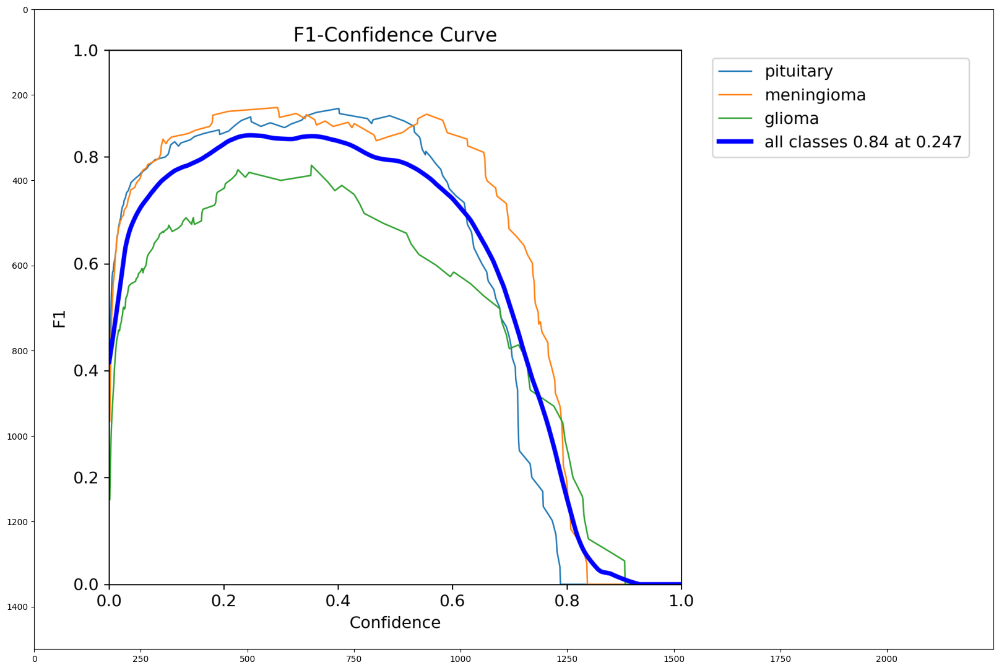

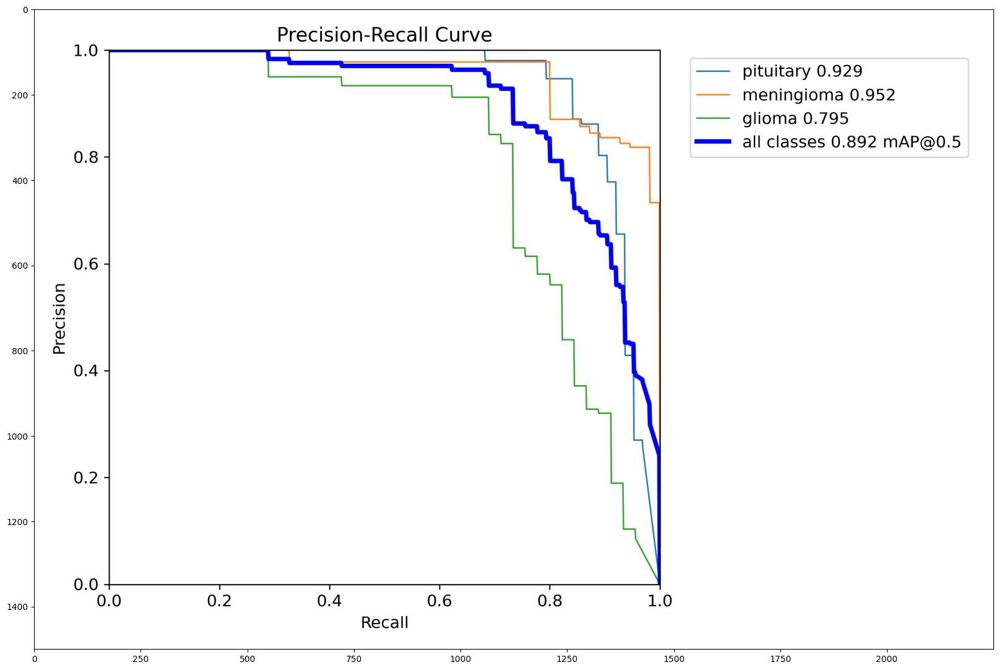

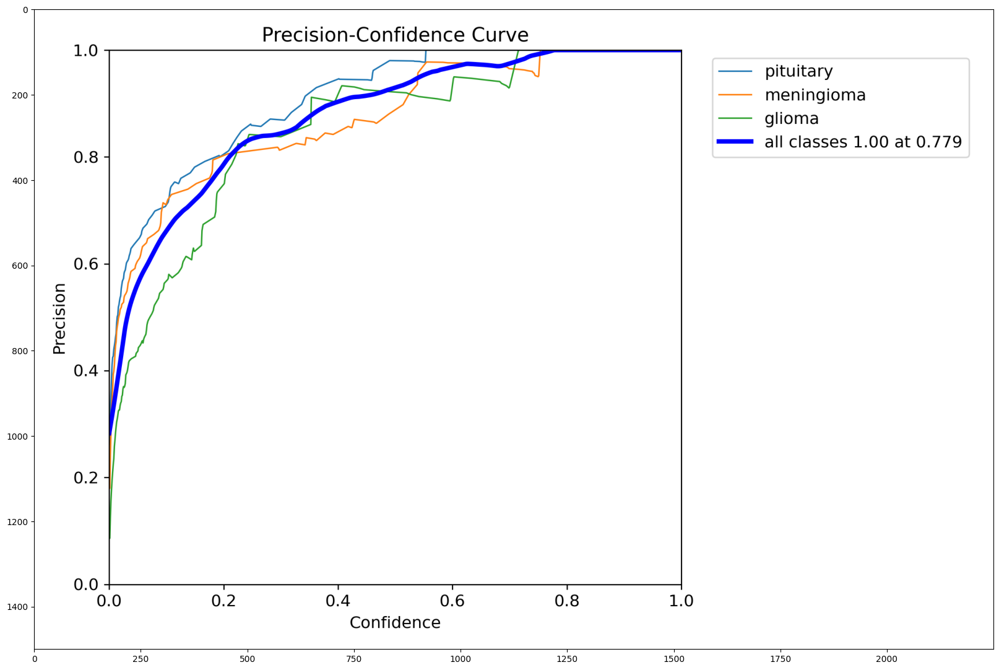

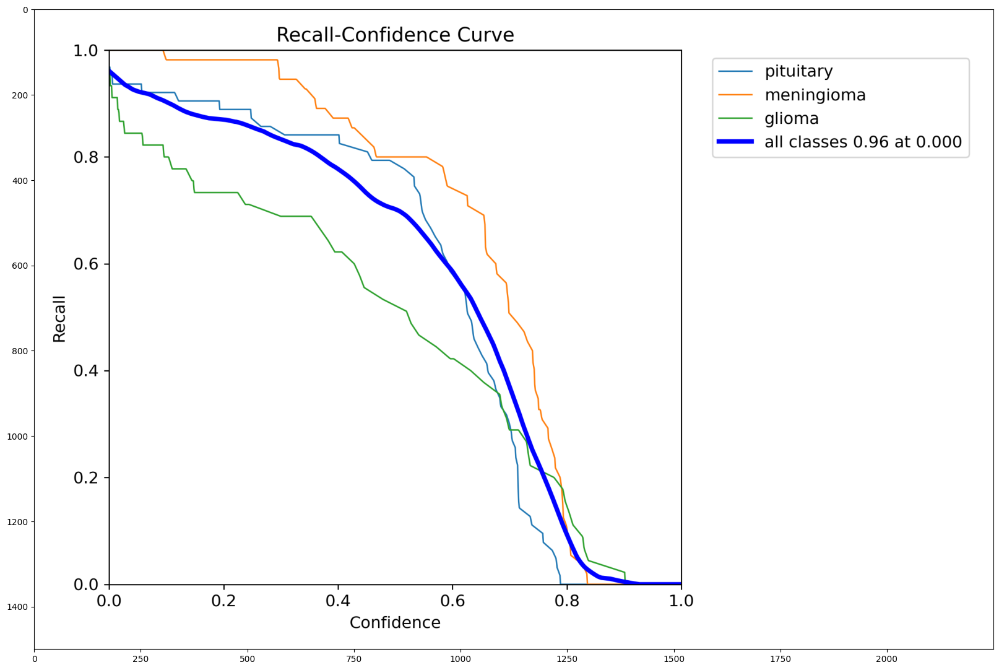

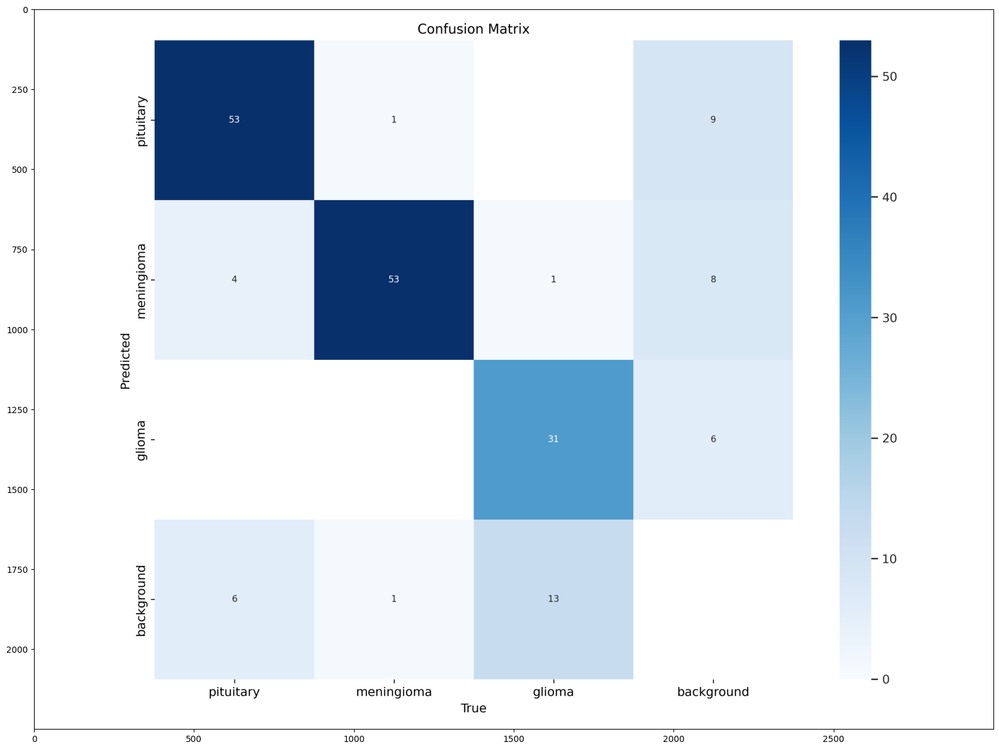

...

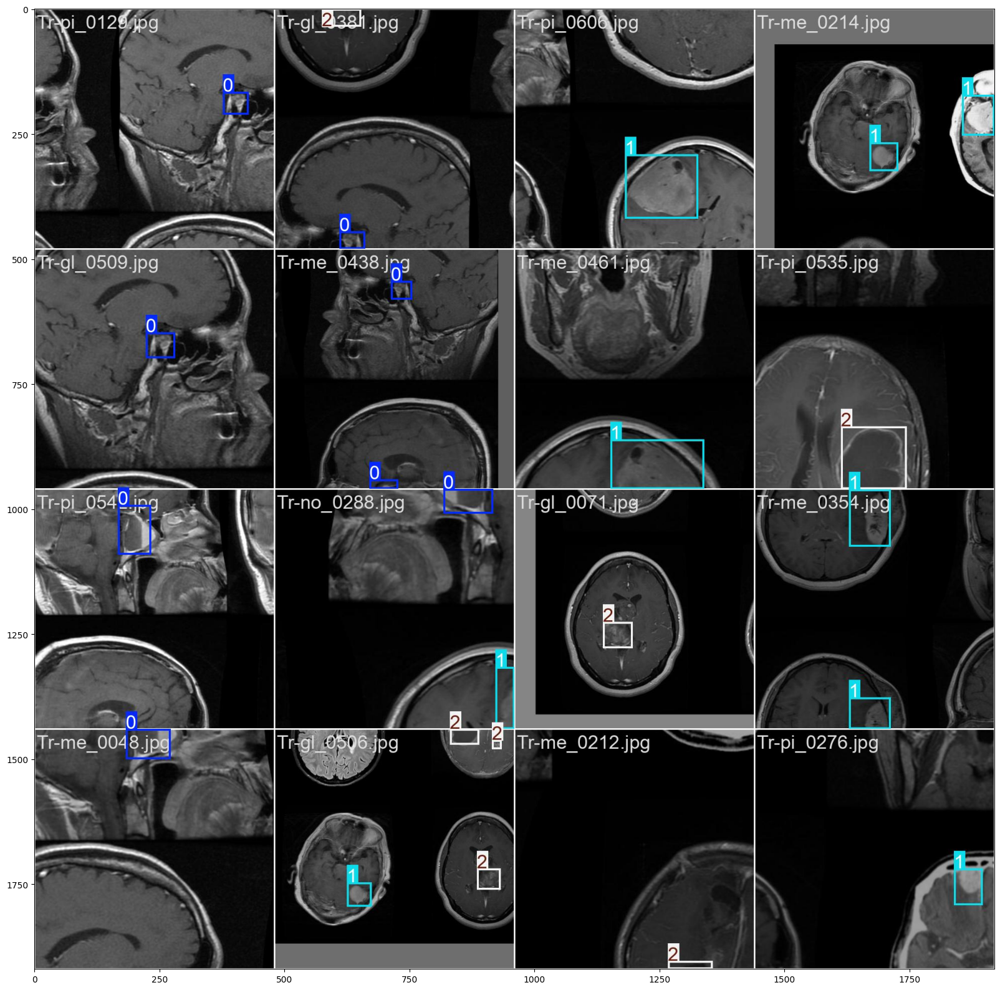

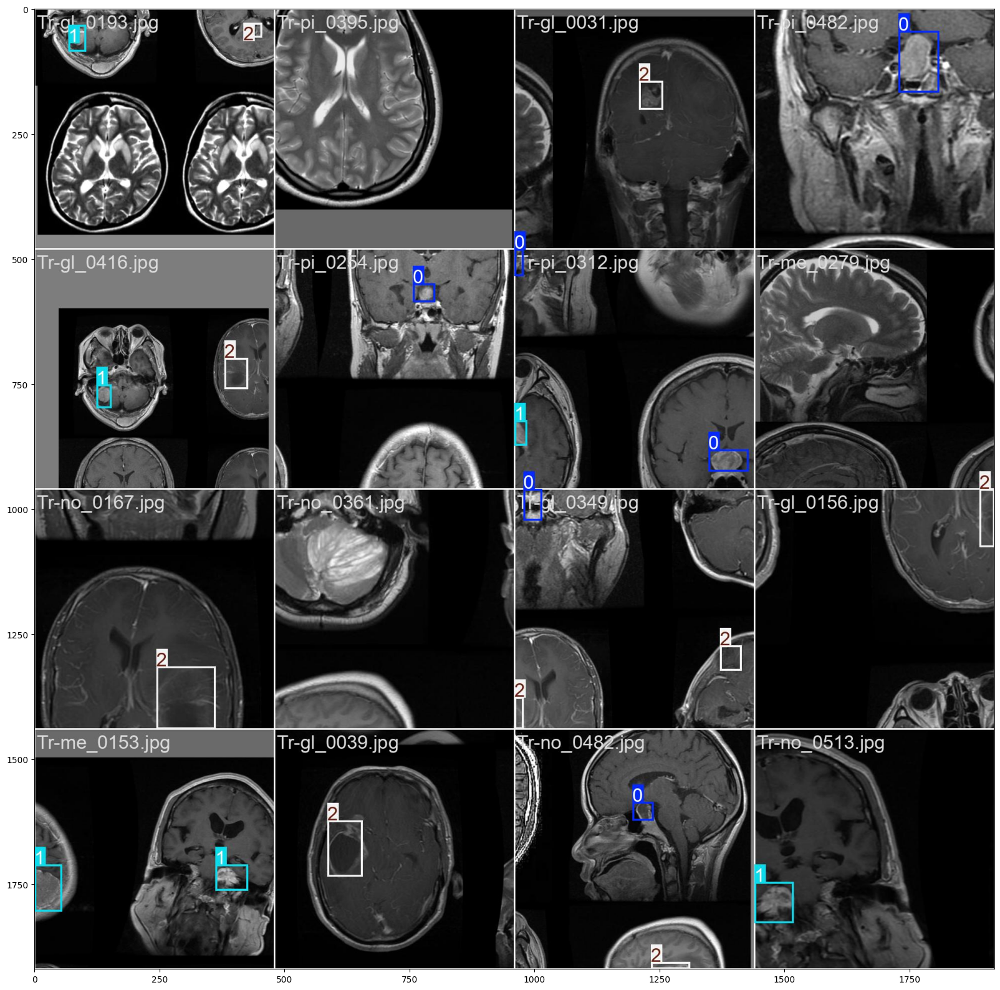

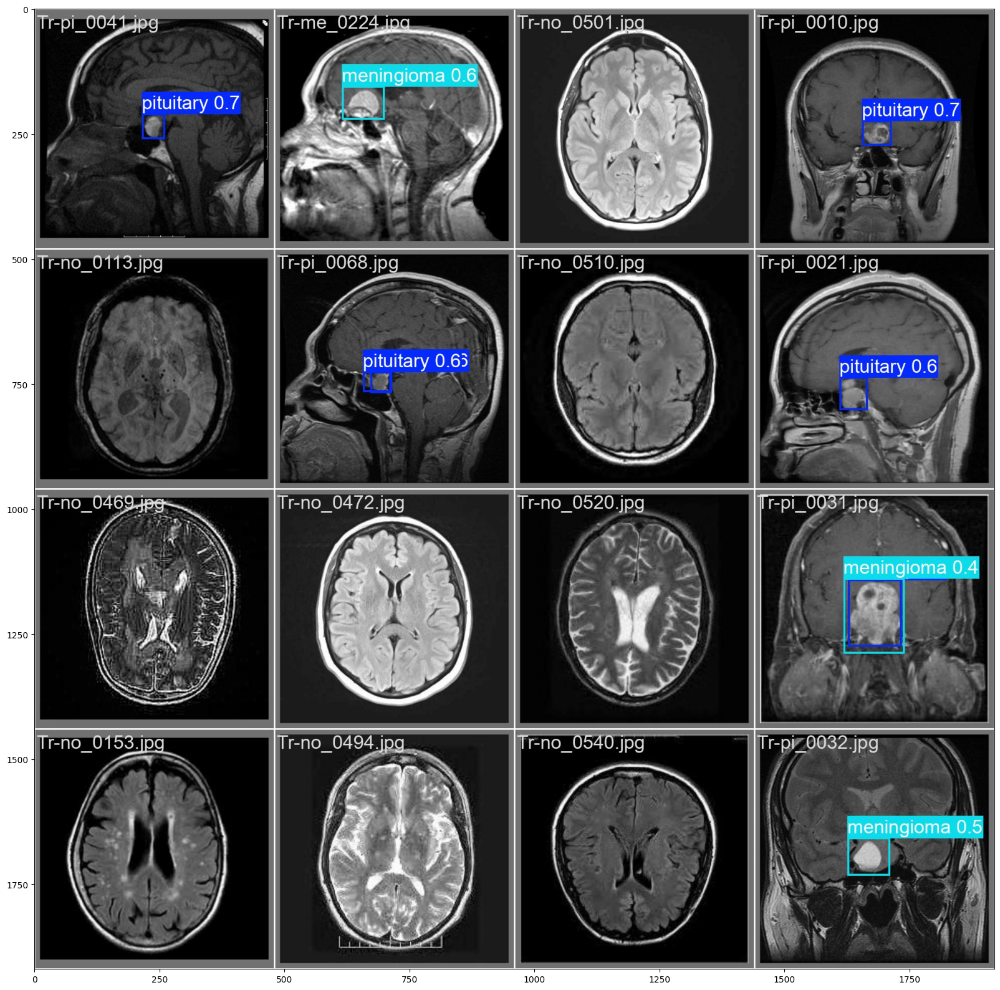

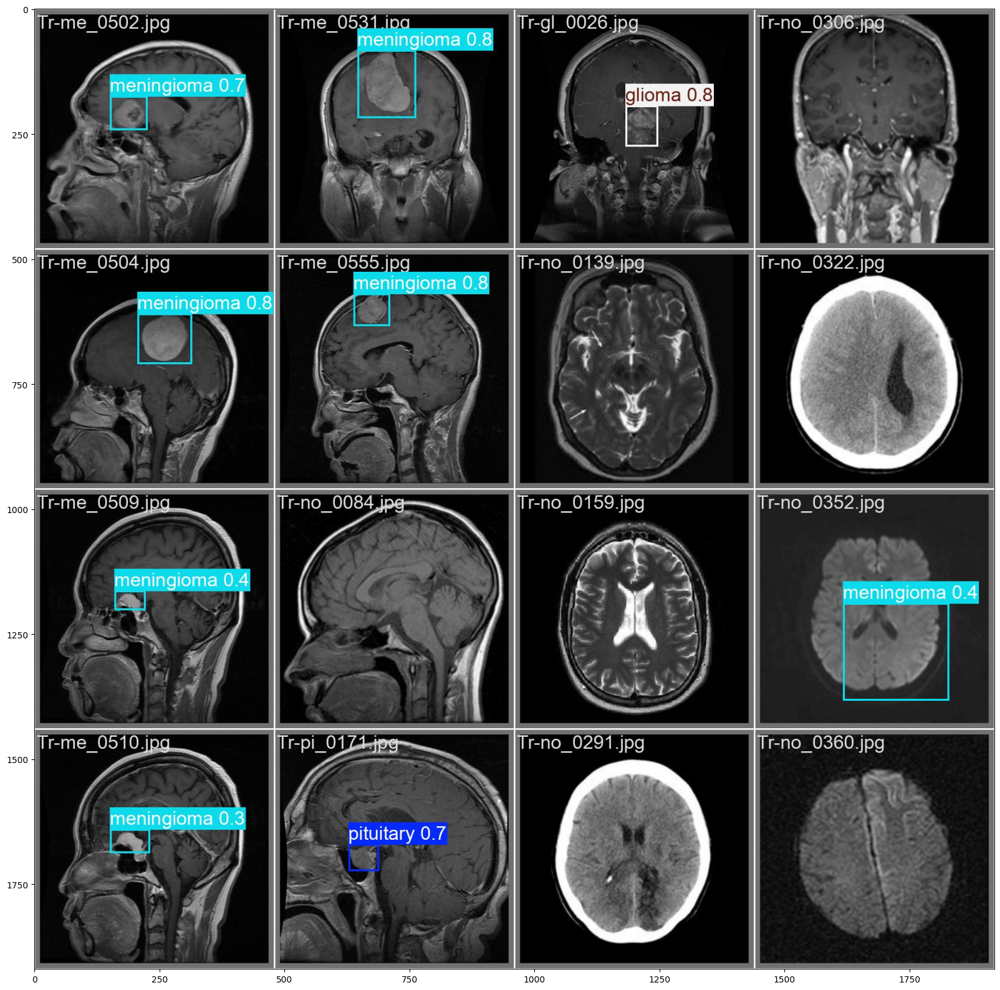

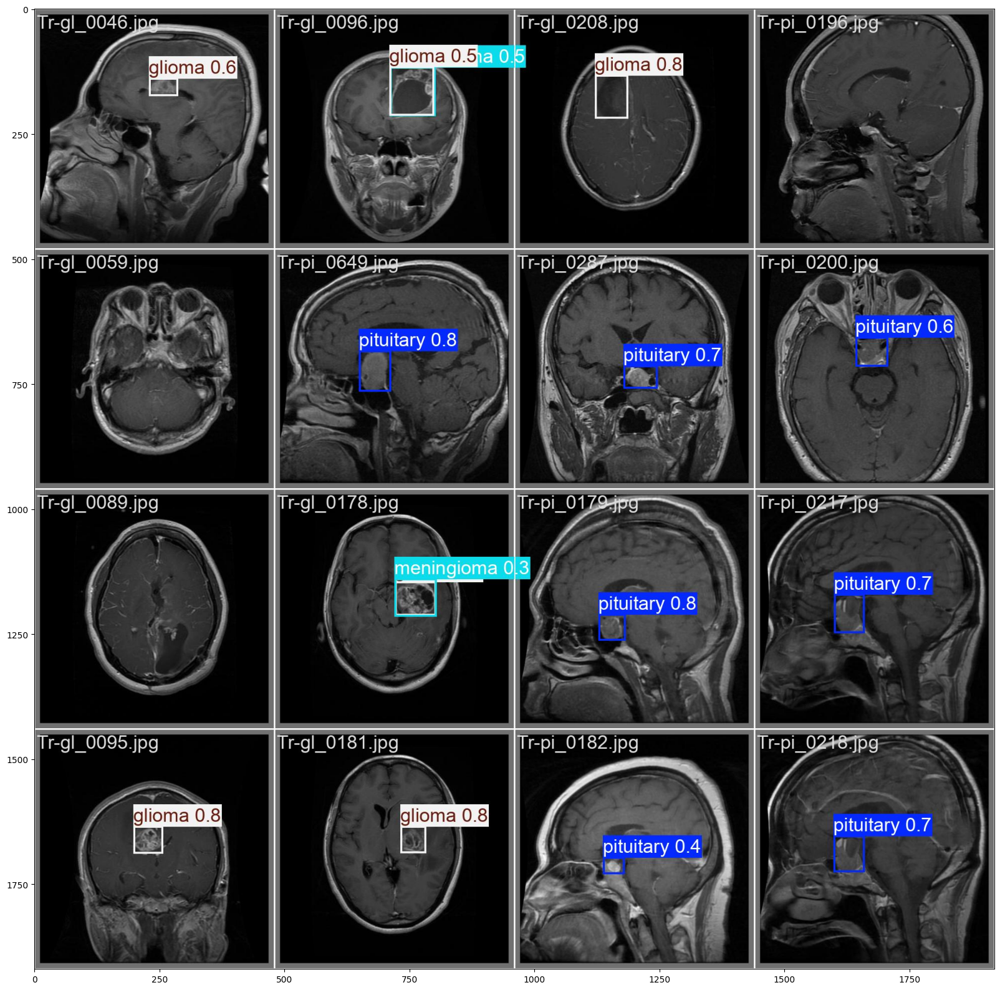

In [5]:
for path in sorted(glob.glob('/kaggle/working/runs/detect/train/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/runs/detect/train/*.jpg')):
    if not path.split('.')[0].endswith('_labels') or path.split('.')[0].startswith('train_'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()

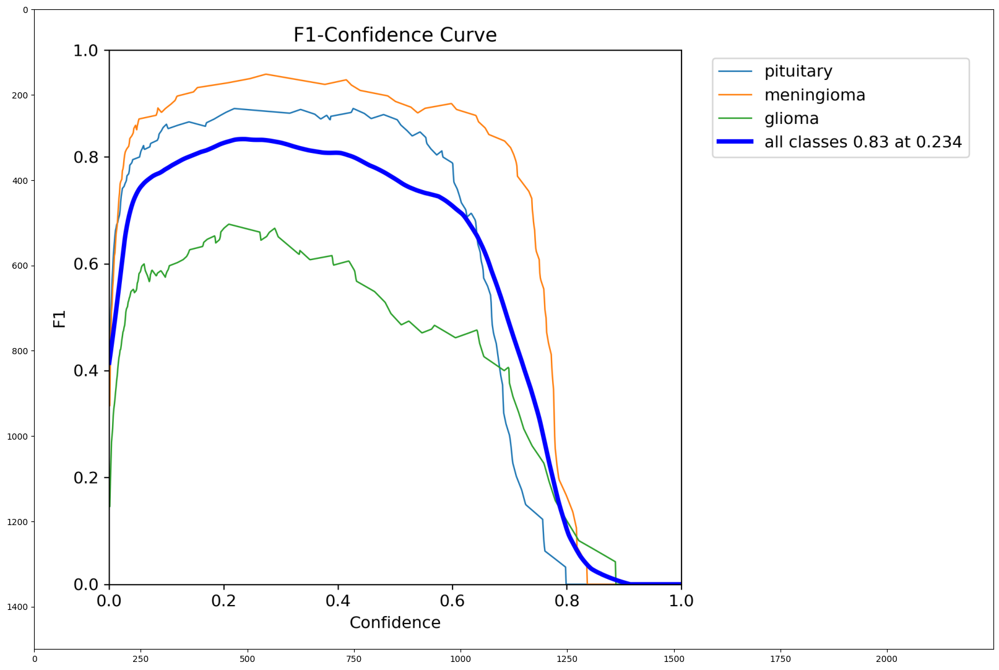

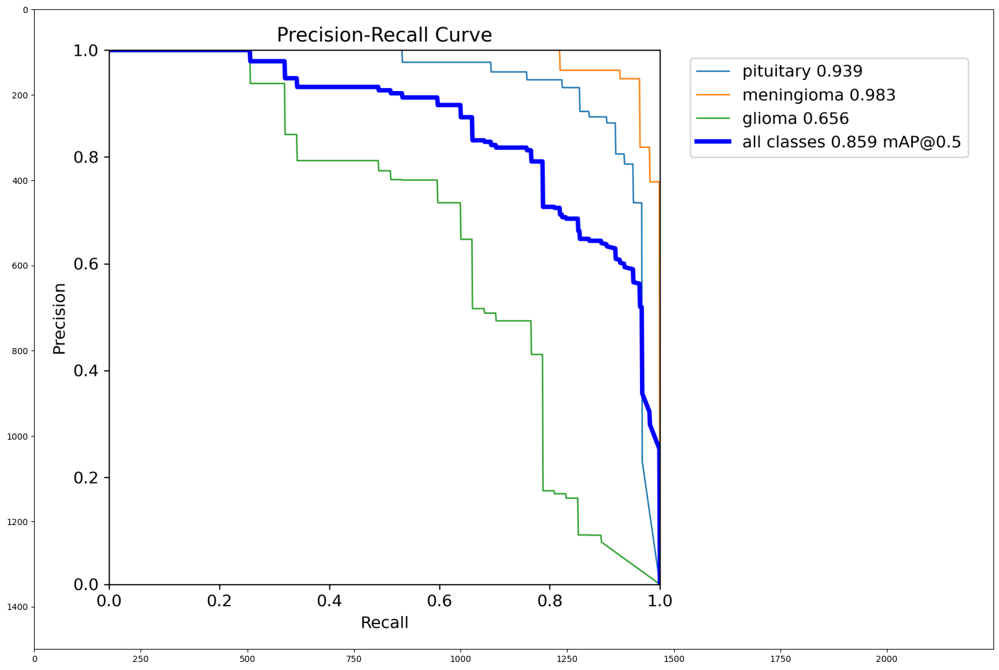

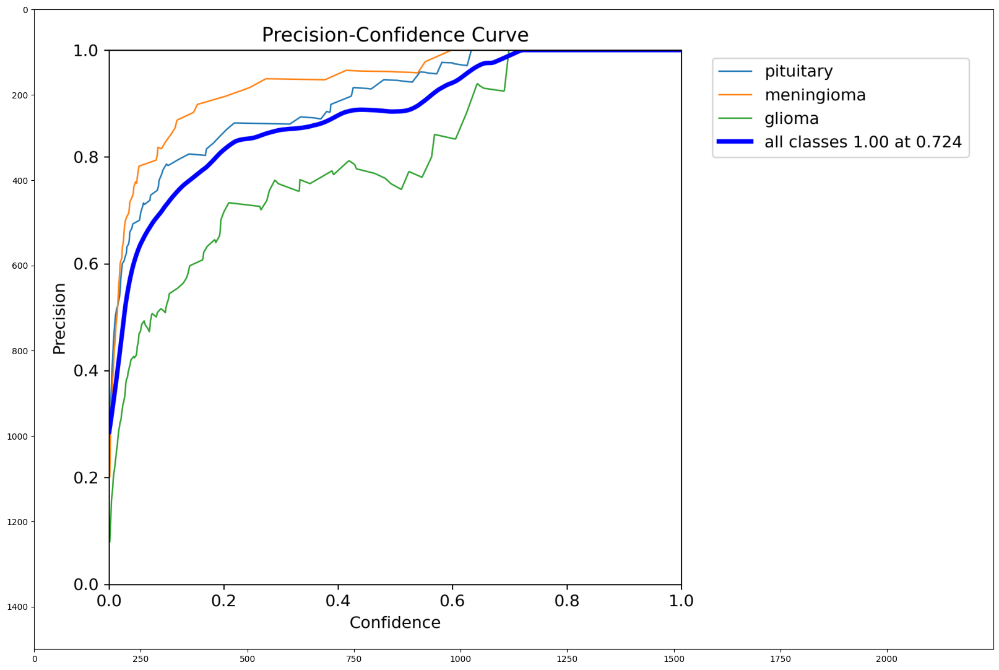

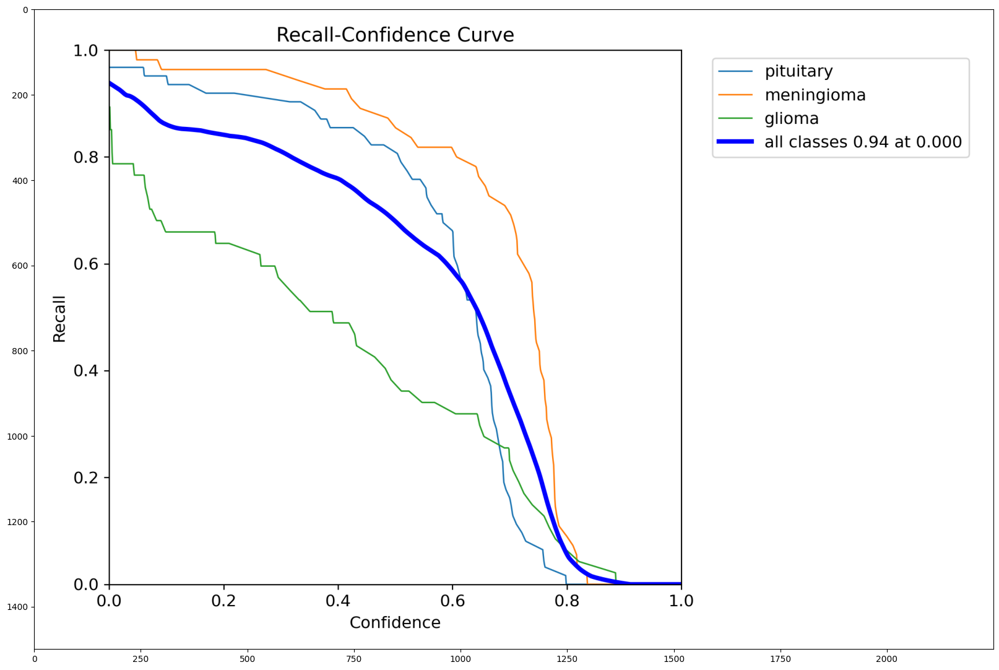

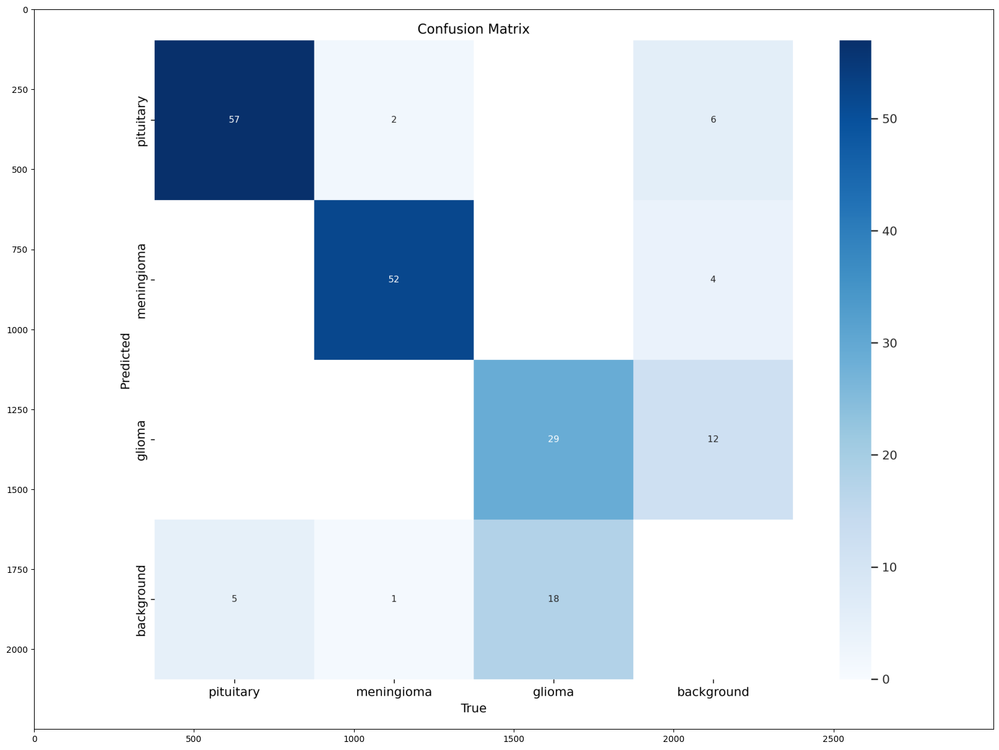

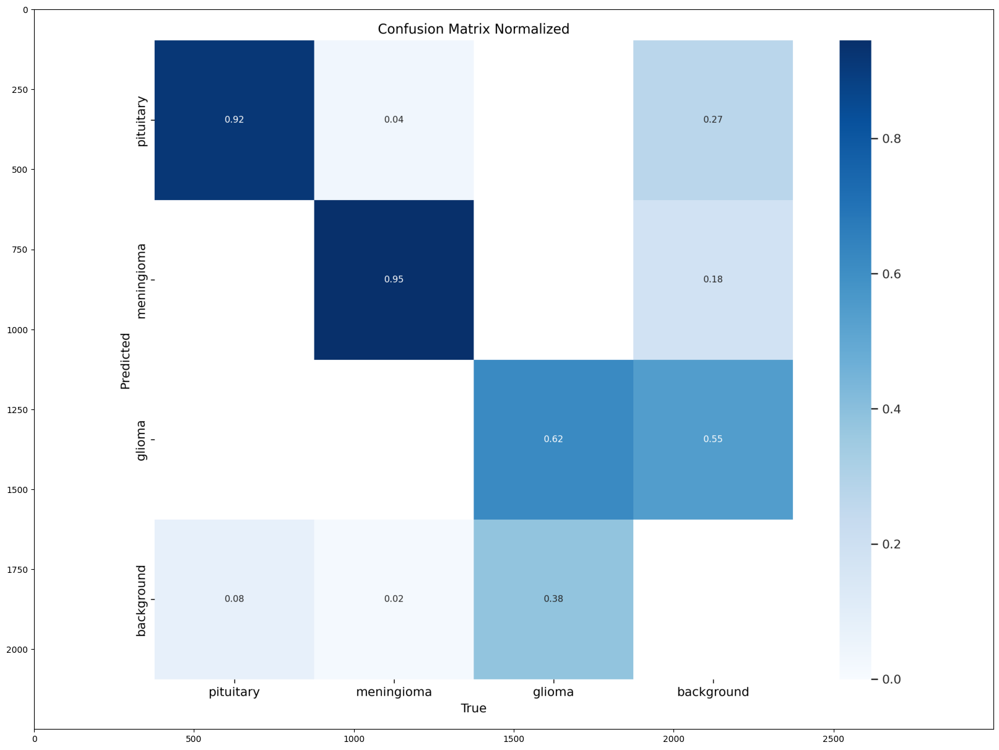

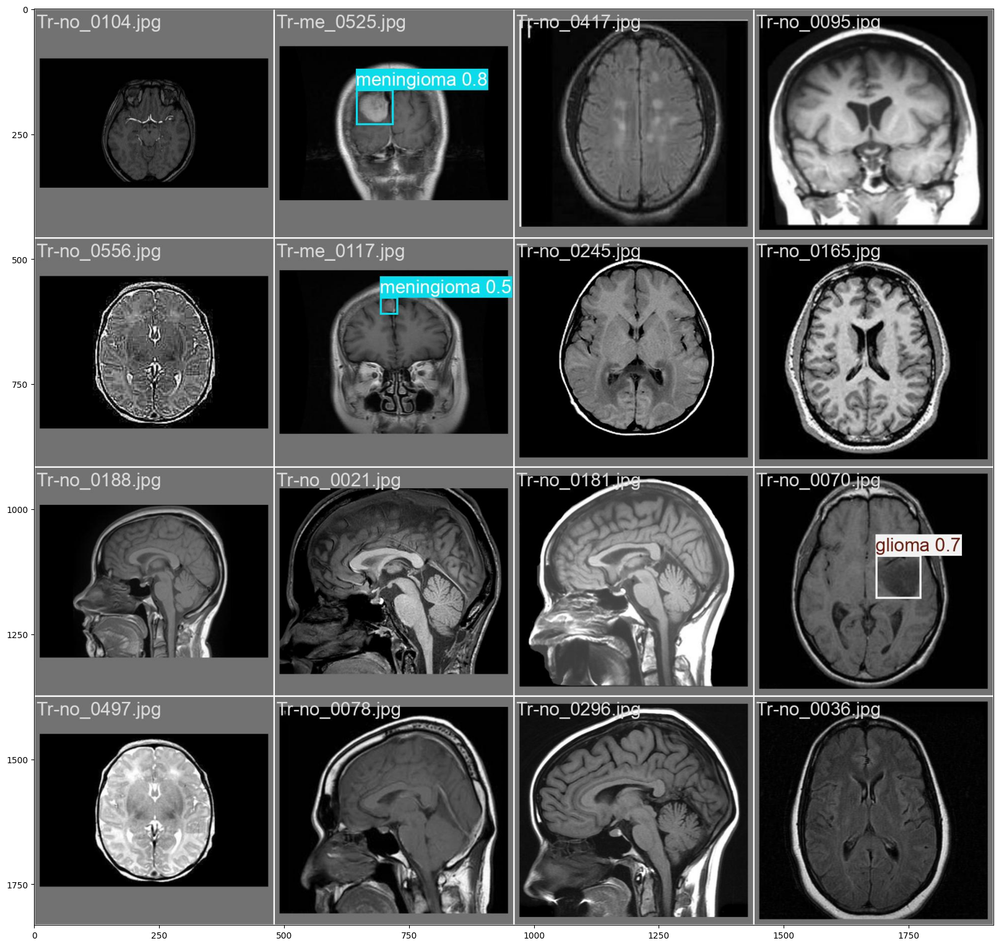

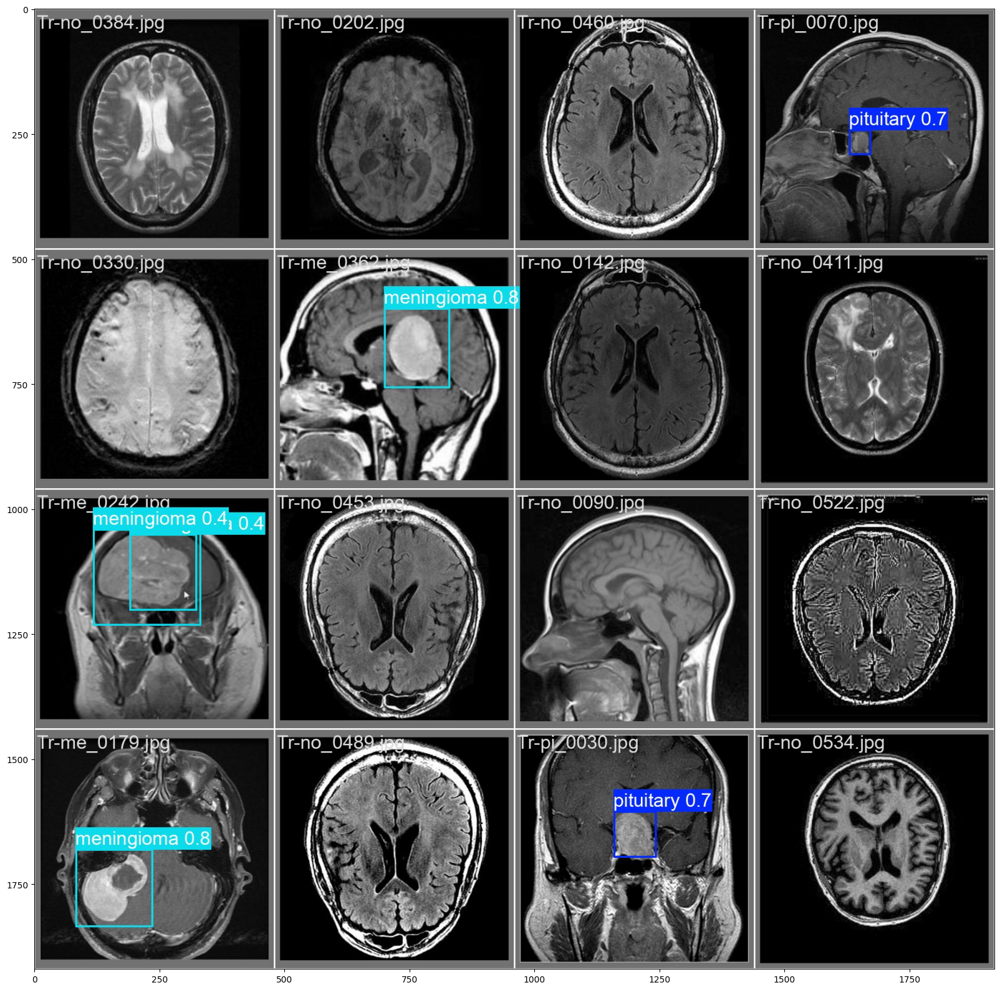

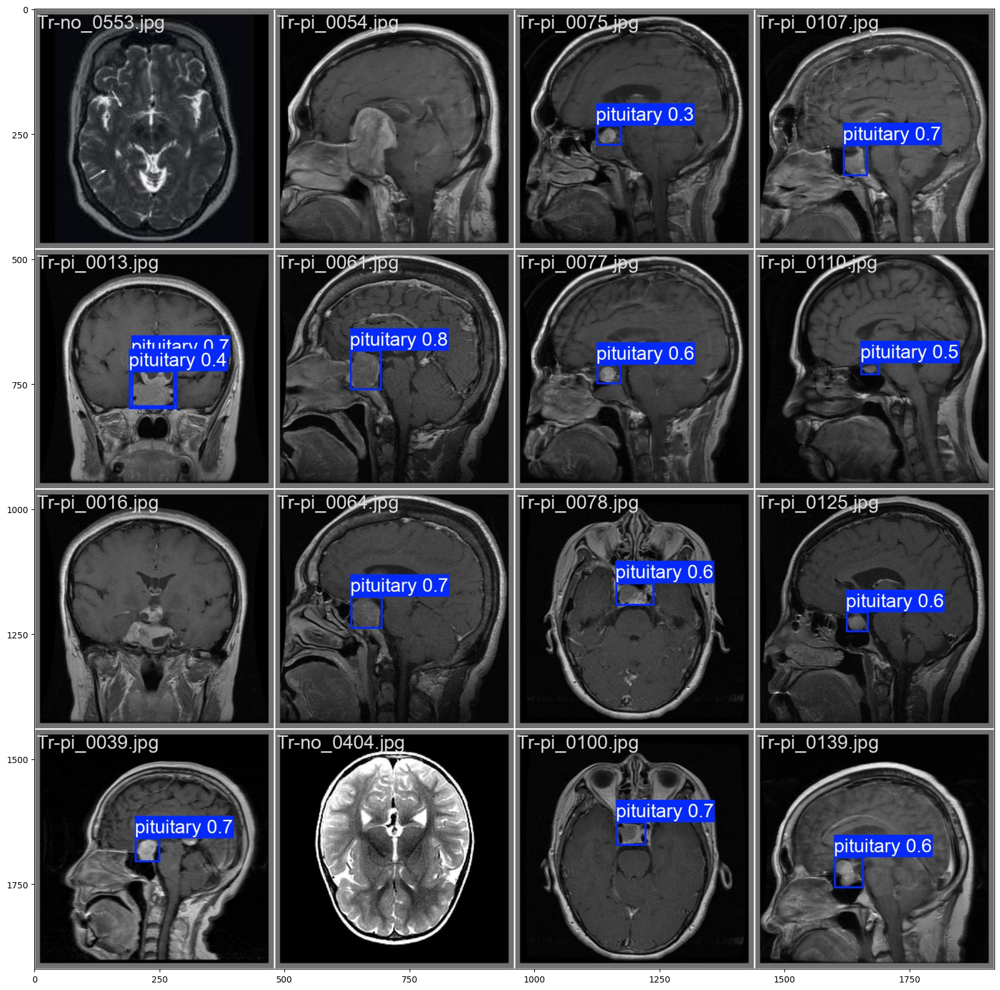

In [6]:
for path in sorted(glob.glob('/kaggle/working/runs/detect/train2/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/runs/detect/train2/*.jpg')):
    if not path.split('.')[0].endswith('_labels'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()